In [20]:
cd /compute1/pranav/LION_N/


/compute1/pranav/LION_N


In [1]:
import sys 
sys.path.insert(1,'/compute1/pranav/LION_N')

In [2]:
import torch
from torch.utils.data import DataLoader
import pickle
from models.distributions import Normal     
import importlib
import matplotlib.pyplot as plt
# import LION_N
import open3d as o3d
import navis
# import open3d as o3d
import torch
import plotly.graph_objs as go
import plotly.subplots as sp
from tqdm import tqdm

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [3]:
def initVAE(sample_points=2048):

    with open("./vae_configs.pkl",'rb') as f:
        (args,config)=pickle.load(f)    
        args.distributed = False
        args.global_size = 1

    config['shapelatent']['decoder_num_points']=sample_points
    config['data']['tr_max_sample_points']=sample_points
    config['data']['te_max_sample_points']=sample_points

    model_lib = importlib.import_module('models.vae_adain')
    model = model_lib.Model(config)
    model.to('cuda')
    return model


def getPointCloudNeuron(neuron,resample_to=2048,plot=True, standardize =True,device='cuda'):
    
    if not isinstance(neuron,navis.TreeNeuron) and  not isinstance(neuron,navis.MeshNeuron):
        neuron =  navis.read_swc(neuron)

    pc_neuron = navis.make_dotprops(neuron)
    pcd = o3d.geometry.PointCloud()
    pcd.points = o3d.utility.Vector3dVector(pc_neuron.points)
    # pp=pcd.uniform_down_sample(every_k_points=2)
    if len(pcd.points)>resample_to:
        ds_pcd=pcd.farthest_point_down_sample(resample_to)
    else:
        ds_pcd =pcd
    if plot:o3d.visualization.draw_plotly([ds_pcd])
    point_tensor =torch.Tensor(ds_pcd.points) [None,:,:]
    if standardize:
        point_tensor=(point_tensor-point_tensor.min())/(point_tensor.max()-point_tensor.min())
        point_tensor = 2 * point_tensor -1
    return point_tensor.to(device)


def vaeinfer(model,point,sty=0):
       
    all_eps=[]
    all_log_q=[]
    latent_list=[]
    class_label =None
    cls_emb=None
    if model.args.data.cond_on_cat: 
        if class_label is not None:
            assert(class_label is not None)
            cls_emb = model.class_embedding(class_label) 
        else:
            assert(cls_emb is not None)

        enc_input = point, cls_emb 
    else:
        enc_input = point 

    z = model.style_encoder(enc_input) 
    z_mu, z_sigma = z['mu_1d'], z['sigma_1d'] # log_sigma
    dist = Normal(mu=z_mu, log_sigma=z_sigma)  # (B, F)

    z_global = dist.sample()[0] 
    # all_eps.append(z_global) 
    # all_log_q.append(dist.log_p(z_global)) 
    # latent_list.append( [z_global, z_mu, z_sigma] )

    style = torch.cat([z_global, cls_emb], dim=1) if model.args.data.cond_on_cat else z_global 
    style = model.style_mlp(style) if model.style_mlp is not None else style  
    style = torch.zeros_like(style)

    z = model.encoder([enc_input,style])
    z_mu, z_sigma = z['mu_1d'], z['sigma_1d'] # log_sigma
    z_sigma = z_sigma - model.args.shapelatent.log_sigma_offset 
    dist = Normal(mu=z_mu, log_sigma=z_sigma)  # (B, F)
    z_local = dist.sample()[0] 
    # all_eps.append(z_global) 
    # all_log_q.append(dist.log_p(z_global)) 
    # latent_list.append( [z_global, z_mu, z_sigma] )

    # ---- decoder ---- #
    x_0_pred = model.decoder(None, beta=None, context=z_local, style=style) 

    return x_0_pred,z_local,style


def plot_multiple_point_clouds(point_clouds,titles):
    """
    Plot multiple point clouds in a single Plotly plot.

    Parameters:
    point_clouds (list of open3d.geometry.PointCloud): List of point clouds to plot.
    """
    # Initialize an empty list to store Plotly scatter traces
    traces = []
    fig = sp.make_subplots(
    rows=1, cols=len(point_clouds),
    specs=[[{'type': 'scatter3d'} for i in range(len(point_clouds))]],
    subplot_titles=tuple(titles)
    )
    # Iterate over the list of point clouds
    for i, points in enumerate(point_clouds):
        # Convert Open3D point cloud to NumPy array
        # points = pc

        # Create a Plotly scatter3d trace
        trace = go.Scatter3d(
            # title=f"cloud{i}",
            x=points[:, 0],
            y=points[:, 1],
            z=points[:, 2],
            mode='markers',
            marker=dict(size=2),
            name=f'Point Cloud {i+1}'
        )

        # Add the trace to the list
        fig.add_trace(trace, row=1, col=i+1)


    # Update layout
    fig.update_layout(
        title=f"Neuron latents in between Neuron A and Neuron B",
        scene=dict(xaxis_title='X Axis', yaxis_title='Y Axis', zaxis_title='Z Axis')
    )

    # Show the plot
    fig.show()

def overlay(y,pred,titles=("Scaled Cut Input", "Reconstructed", "Overlayed")):
    with torch.no_grad():
        points1 = y[0].cpu().detach().numpy()

        points2 = pred[0].cpu().detach().numpy()


        scatter1 = go.Scatter3d(
            x=points1[:, 0],
            y=points1[:, 1],
            z=points1[:, 2],
            mode='markers',
            marker=dict(size=2),
            name='Point Cloud 1'
        )

        scatter2 = go.Scatter3d(
            x=points2[:, 0],
            y=points2[:, 1],
            z=points2[:, 2],
            mode='markers',
            marker=dict(size=2),
            name='Point Cloud 2'
        )

        # Create subplots
        fig = sp.make_subplots(
            rows=1, cols=3,
            specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}, {'type': 'scatter3d'}]],
            subplot_titles=titles
        )

        # Add traces to the subplots
        fig.add_trace(scatter1, row=1, col=1)
        fig.add_trace(scatter2, row=1, col=2)
        fig.add_trace(scatter1, row=1, col=3)
        fig.add_trace(scatter2, row=1, col=3)

        # Update layout
        fig.update_layout(
            title=f"Loss= {((y - pred)**2).sum()}",
            scene=dict(xaxis_title='X Axis', yaxis_title='Y Axis', zaxis_title='Z Axis')
        )

        # Show the plot
        fig.show()

In [62]:
ls ../exp/0718/neuron/

b00fdfh_hvae_lion_B32/


In [5]:
lop=torch.load("./lion_ckpt/unconditional/all55/checkpoints/vae_only.pt",map_location="cpu")
lop=torch.load("../exp/0721/neuron/a85d8ah_hvae_lion_B32/checkpoints/best_eval.pth",map_location="cpu")
# lop=torch.load("../exp/0719/neuron/b460e0h_hvae_lion_B32/checkpoints/best_eval.pth",map_location="cpu")
vae=initVAE(4096)
vae.load_state_dict(lop['model'])

2024-07-22 23:54:58.258 | INFO     | utils.model_helper:import_model:106 - import: models.shapelatent_modules.PointNetPlusEncoder
2024-07-22 23:54:58.262 | INFO     | models.shapelatent_modules:__init__:29 - [Encoder] zdim=128, out_sigma=True; force_att: 0
2024-07-22 23:54:58.262 | INFO     | utils.model_helper:import_model:106 - import: models.latent_points_ada.PointTransPVC
2024-07-22 23:54:58.263 | INFO     | models.latent_points_ada:__init__:38 - [Build Unet] extra_feature_channels=0, input_dim=3
2024-07-22 23:54:58.324 | INFO     | utils.model_helper:import_model:106 - import: models.latent_points_ada.LatentPointDecPVC
2024-07-22 23:54:58.324 | INFO     | models.latent_points_ada:__init__:241 - [Build Dec] point_dim=3, context_dim=1
2024-07-22 23:54:58.326 | INFO     | models.latent_points_ada:__init__:38 - [Build Unet] extra_feature_channels=1, input_dim=3
2024-07-22 23:54:58.397 | INFO     | models.vae_adain:__init__:50 - [Build Model] style_encoder: models.shapelatent_modules.P

<All keys matched successfully>

In [6]:
from datasets.neuron_datasets import NeuronPointClouds
train_dataset= NeuronPointClouds( tr_sample_size=4096,
                 te_sample_size=4096,
                 split='train',
                 splits={"train":0.8,"val":0.2},
                 scale=1.,
                 standardize=True,
                 normalize_global=True,
                 recenter_per_shape=False,
                 all_points_mean=None,
                 all_points_std=None,
                 input_dim=3, 
                 sampling="random",
                 )

val_dataset= NeuronPointClouds( tr_sample_size=4096,
                 te_sample_size=4096,
                 split='val',
                 splits={"train":0.8,"val":0.2},
                 scale=1.,
                 standardize=True,
                 normalize_global=True,
                 recenter_per_shape=False,
                 all_points_mean=None,
                 all_points_std=None,
                 input_dim=3, 
                 sampling="random",
                 )

##############################################################################
##############################################################################
##############################################################################
##############################################################################
##############################################################################
##############################################################################
##############################################################################
##############################################################################


In [13]:
# train_example = train_dataset.__getitem__(2578)['input_pts'].numpy()
# plot_multiple_point_clouds([train_example],["w"])

In [26]:

pt_trch =val_dataset.__getitem__(1842)['input_pts'][None,:,:].to("cuda")
na_pred, za, stya =vaeinfer(vae,pt_trch)
# na_pred_npy = na_pred.detach().cpu().numpy()
# plot_multiple_point_clouds([train_example,na_pred[0]],["k","w"])

In [27]:
overlay(pt_trch,na_pred,("Scaled Input", "Reconstructed", "Overlayed"))

In [10]:
mesh = navis.read_mesh('../295779961.obj')
mesh_points = navis.make_dotprops(mesh)

In [23]:
point_cloud_neuron =o3d.geometry.PointCloud(  o3d.utility.Vector3dVector(mesh_points.points))

In [ ]:
o3d.visualization.draw([point_cloud_neuron])

In [15]:
with torch.no_grad():
    mesht=torch.from_numpy(mesh_points.points)
    mesht=(mesht - mesht.mean(0))/mesht.std(0)
    mesht=mesht[None,:,:].to("cuda").float()
    na_pred, za, stya =vaeinfer(vae,mesht)
    print(((mesht-na_pred)**2).sum())

tensor(1056.1345, device='cuda:0')


In [27]:
import numpy as np
idx = np.random.choice(584242,50000,replace=False)

In [28]:
pt1 =mesht.cpu()[:,idx]
pt2 = na_pred.cpu()[:,idx]

In [29]:
overlay(pt1,pt2,("Scaled Input", "Reconstructed", "Overlayed"))

In [15]:
val_loader = DataLoader(dataset=val_dataset,
                                   batch_size=32,
                                   num_workers=2,
                                   drop_last=True,
                                   pin_memory=False)

loss=[]
with torch.no_grad():
    for y in tqdm(val_loader):
        pred, za, stya =vaeinfer(vae,y['input_pts'].cuda())
        loss.append( ((y['input_pts']-pred.cpu())**2).sum((1,2)))
vlossb4=torch.hstack(loss)

100%|██████████| 161/161 [00:48<00:00,  3.35it/s]


In [16]:
vlosst4.sum(),vlosst4.mean(),vlossb4.sum(),vlossb4.mean()

(tensor(171070.0312), tensor(33.2046), tensor(46693.8398), tensor(9.0632))

In [117]:
vlosst.sum(),vlosst.mean(),vlossb.sum(),vlossb.mean()

(tensor(88670.6719), tensor(17.2109), tensor(23514.5293), tensor(4.5642))

In [104]:
losst.sum(),losst.mean(),lossb.sum(),lossb.mean()

(tensor(352315.), tensor(17.0168), tensor(94348.9375), tensor(4.5570))

tensor([3.4426, 3.6018, 3.4221,  ..., 5.5636, 3.5914, 4.3669])

(array([0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00,
        2.000e+00, 1.000e+00, 9.000e+00, 1.100e+01, 2.200e+01, 4.700e+01,
        7.700e+01, 1.640e+02, 2.750e+02, 4.750e+02, 7.850e+02, 1.009e+03,
        1.297e+03, 1.402e+03, 1.541e+03, 1.479e+03, 1.337e+03, 1.204e+03,
        1.076e+03, 9.800e+02, 7.990e+02, 6.550e+02, 5.880e+02, 5.220e+02,
        4.570e+02, 3.830e+02, 3.270e+02, 3.070e+02, 2.750e+02, 2.360e+02,
        2.090e+02, 1.930e+02, 1.850e+02, 1.590e+02, 1.550e+02, 1.500e+02,
        1.460e+02, 1.040e+02, 1.070e+02, 8.500e+01, 9.400e+01, 7.600e+01,
        5.900e+01, 6.100e+01, 6.400e+01, 6.100e+01, 4.600e+01, 5.800e+01,
        4.900e+01, 5.200e+01, 2.700e+01, 4.100e+01, 3.100e+01, 2.600e+01,
        3.700e+01, 2.700e+01, 2.200e+0

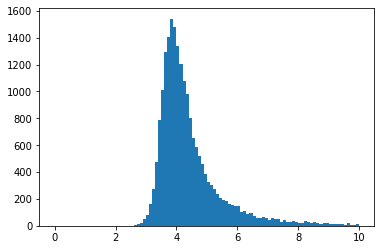

In [103]:
# loss pure best_eval 7/21
plt.hist(lossb.numpy(),100,[0,10])

(array([  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   1.,   2.,   9.,  12.,  26.,  43.,
         82.,  93., 147., 224., 282., 346., 472., 585., 711., 746., 909.,
        919., 973., 950., 963., 889., 887., 849., 700., 717., 667., 550.,
        533., 468., 371., 384., 331., 292., 293., 293., 240., 228., 217.,
        207., 175., 151., 158., 138., 132., 123., 127., 119.,  89.,  95.,
        107.,  90.,  83.,  94.,  65.,  63.,  60.,  57.,  58.,  53.,  33.,
         41.,  48.,  58.,  36.,  27.,  28.,  40.,  35.,  26.,  25.,  26.,
         21.]),
 array([ 0. ,  0.3,  0.6,  0.9,  1.2,  1.5,  1.8,  2.1,  2.4,  2.7,  3. ,
         3.3,  3.6,  3.9,  4.2,  4.5,  4.8,  5.1,  5.4,  5.7,  6. ,  6.3,
         6.6,  6.9,  7.2,  7.5,  7.8,  8.1,  8.4,  8.7,  9. ,  9.3,  9.6,
         9.9, 10.2, 10.5, 10.8, 11.1, 11.4, 11.7, 12. , 12.3, 12.6, 12.9,
        13.2, 13.5, 13

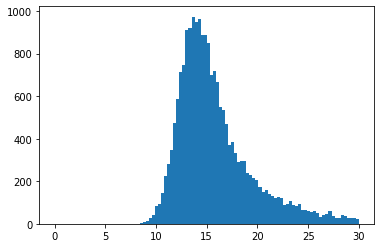

In [91]:
# loss pure vae_all
# vae_all 11000

plt.hist(losst.numpy(),100,[0,30])

In [89]:
lookup={swc:idx for idx,swc in enumerate(train_dataset.swc_list)}
ref =295779961
lookup[f"{ref}.npy"]

14682

In [25]:
vae.get_loss(pt_trch,it=1)['loss']

tensor([11022.3691], device='cuda:0', grad_fn=<AddBackward0>)

In [38]:
example_airplane=torch.load("datasets/ref_val_car.pt")
ex_pts=example_airplane['ref'].to('cuda')

point = ex_pts[0:1]

In [35]:
ex_pts.shape

torch.Size([405, 2048, 3])